# Stopping Customers from Leaving
Goal is to figure out how to retain customers.. rather than just randomly deploying loyalty programs and techniques.

In [1]:
pip install --upgrade Pillow

In [2]:
pip install --upgrade pip

Note: you may need to restart the kernel to use updated packages.


# 1. Import Data

In [26]:
import pandas as pd
import numpy as np
df = pd.read_csv('classificationdata.csv', index_col='id')
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


# 2. Split Data to Prevent Snooping Bias

In [4]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.2, random_state=42)

In [5]:
train.shape, test.shape

((13794, 24), (3449, 24))

# 3. Exploratory Data Analysis

In [6]:
from matplotlib import pyplot as plt

## Bird Eye view

In [7]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13794 entries, 4115 to 15795
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     13794 non-null  object 
 1   tenure                         13794 non-null  int64  
 2   contract_length                13755 non-null  float64
 3   promotions_offered             13755 non-null  object 
 4   remaining_term                 13755 non-null  float64
 5   last_nps_rating                13755 non-null  float64
 6   area_code                      13783 non-null  object 
 7   international_plan             13794 non-null  object 
 8   voice_mail_plan                13765 non-null  object 
 9   number_vmail_messages          13794 non-null  int64  
 10  total_day_minutes              13794 non-null  float64
 11  total_day_calls                13794 non-null  int64  
 12  total_day_charge               13794 non-nu

In [8]:
df.isnull().sum()

state_code                        0
tenure                            0
contract_length                  47
promotions_offered               47
remaining_term                   47
last_nps_rating                  47
area_code                        12
international_plan                0
voice_mail_plan                  30
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                18
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            47
dtype: int64

In [9]:
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,13794.000000,13755.000000,13755.000000,13755.000000,13794.000000,13794.000000,13794.000000,13794.000000,13777.000000,13794.00000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000
mean,100.150935,15.911668,11.134642,6.105416,8.641293,180.387681,100.135566,30.669582,200.355776,100.31115,17.028550,199.626354,100.017254,8.982633,10.301534,4.942366,2.774668,1.552414
std,39.739927,4.883994,7.211600,2.726455,13.035855,54.387496,20.053699,9.254292,50.798903,19.90521,4.317780,51.130423,20.370166,2.297606,2.774209,2.507080,0.741838,1.315480
min,1.000000,8.000000,1.000000,1.000000,0.000000,0.005090,1.000000,0.027050,5.367495,1.00000,1.082034,3.896507,4.000000,0.500865,0.032252,0.000000,0.013478,0.000000
25%,72.000000,12.000000,5.000000,4.000000,1.000000,143.371825,87.000000,24.424805,166.897648,87.00000,14.155799,165.217013,86.000000,7.442417,8.537325,3.000000,2.302714,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,180.183814,100.000000,30.612589,200.905248,101.00000,17.064639,198.672681,100.000000,8.948534,10.375841,5.000000,2.809933,1.000000
75%,127.000000,20.000000,18.000000,8.000000,16.000000,217.693930,113.000000,36.964816,234.285354,114.00000,19.900518,234.484643,114.000000,10.538363,12.072012,6.000000,3.258496,2.000000
max,242.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.643745,169.00000,30.515222,394.851052,173.000000,17.700351,19.981388,20.000000,5.360148,9.000000


In [10]:
train.describe(include='object')

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,13794,13755,13783,13794,13765,13755
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,450,12512,6819,12481,10160,11778


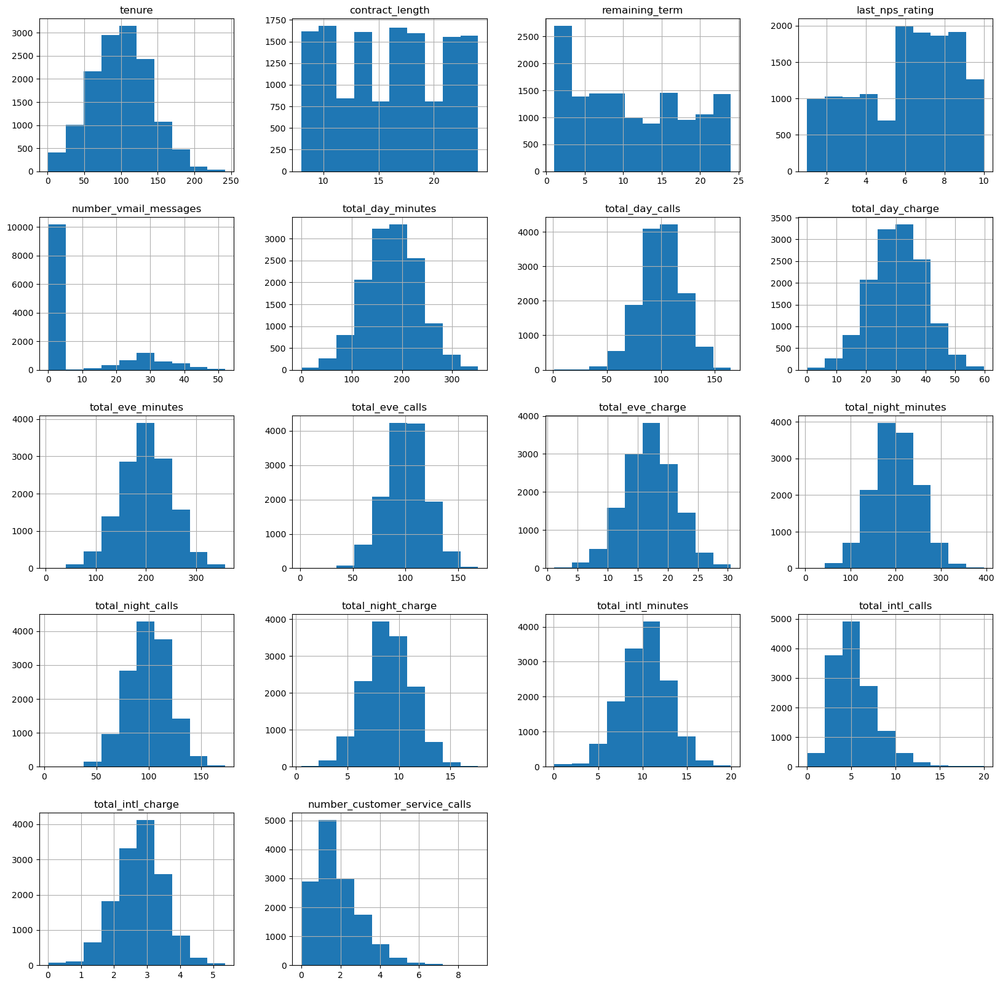

In [11]:
train.hist(figsize=(20,20))
plt.show()

## Faster EDA with Pandas Profiling

In [12]:
pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [13]:
pip install ydata-profiling

Note: you may need to restart the kernel to use updated packages.


In [14]:
from ydata_profiling import ProfileReport

In [15]:
# create new profile report
profile = ProfileReport(train, title='Pandas Profiling Report')

In [16]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analyse Categorical Features

### Inspect Target Features

In [17]:
from matplotlib import pyplot as plt
import seaborn as sns

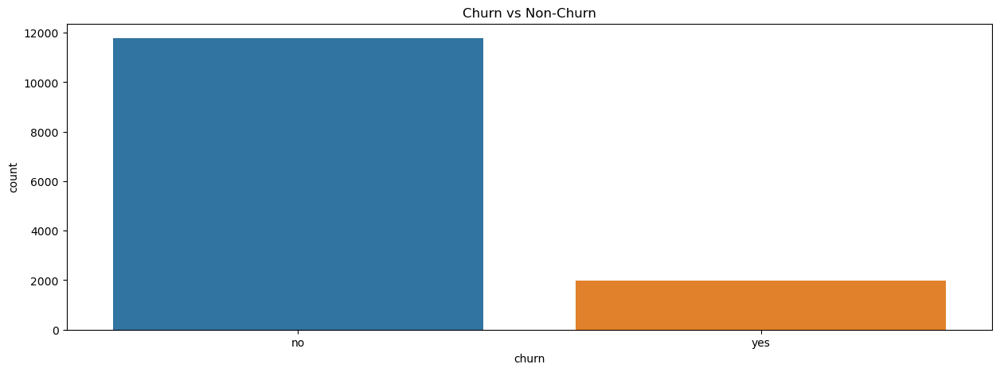

In [18]:
plt.figure(figsize=(15,5))
sns.countplot(x='churn', data=train).set_title('Churn vs Non-Churn')
plt.show()

### Inspect State, Area Code and Promotions Offered

In [19]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

## Analyse Relationships

### Look into Numeric/Numeric Correlation

In [20]:
import seaborn as sns

C:\Users\16178\AppData\Local\Temp\ipykernel_10844\1524494364.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(train.corr())


<AxesSubplot:>

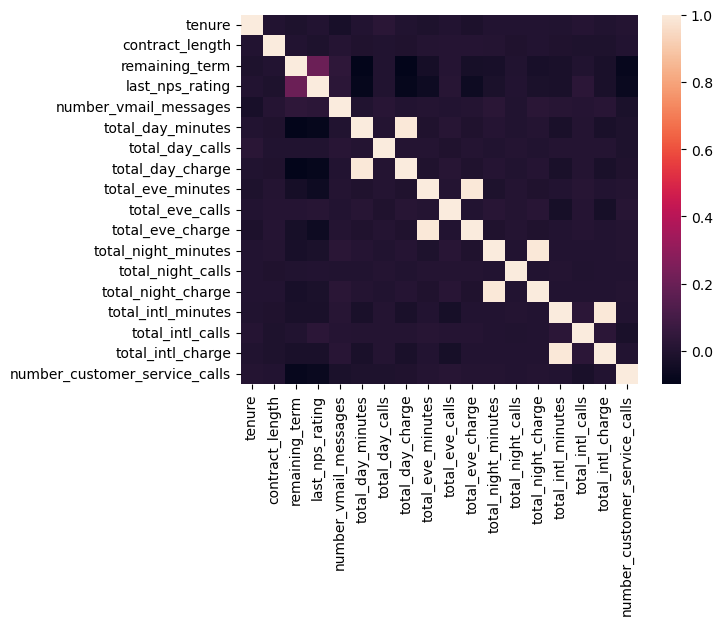

In [21]:
sns.heatmap(train.corr())

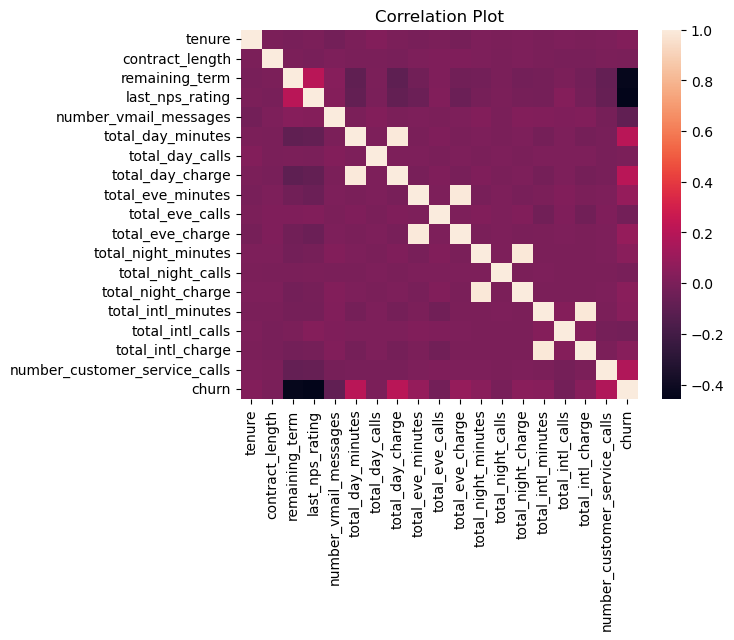

In [23]:
## add churn into the heatmap
temp = train.copy()
temp['churn'] = temp['churn'].apply(lambda x: 1 if x=='yes' else 0)
sns.heatmap(temp.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

If customers are being here for awhile and been giving positive rating, they are not likely to churn..

### Plot Churn Distributions

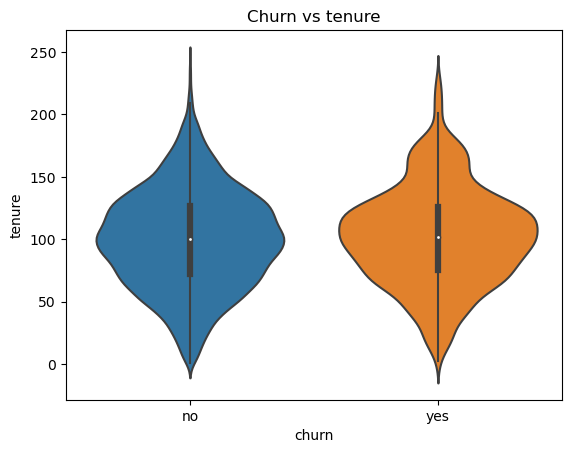

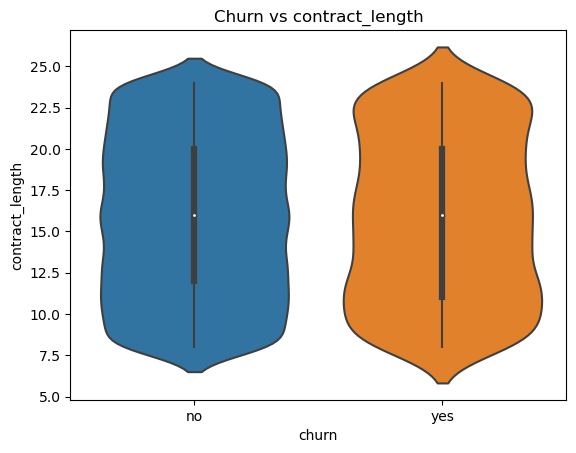

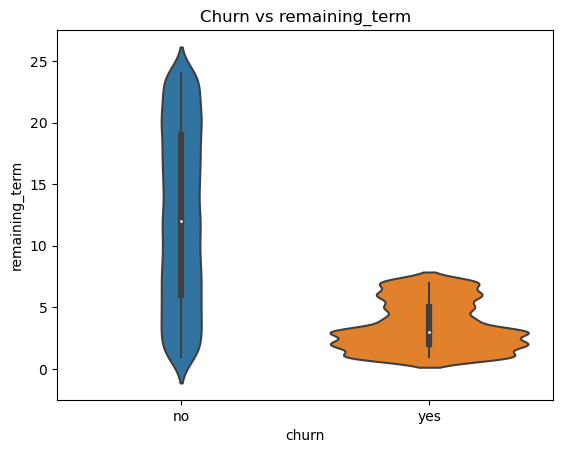

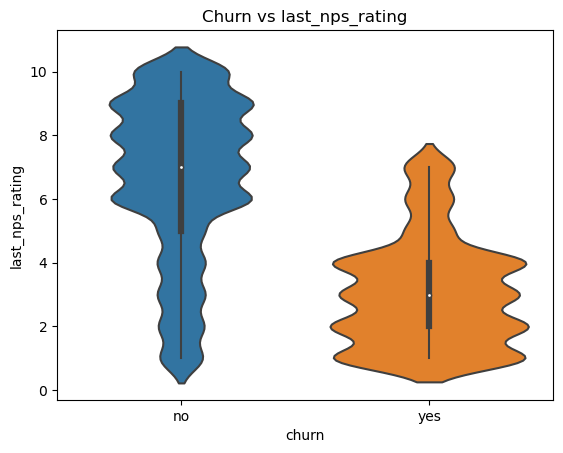

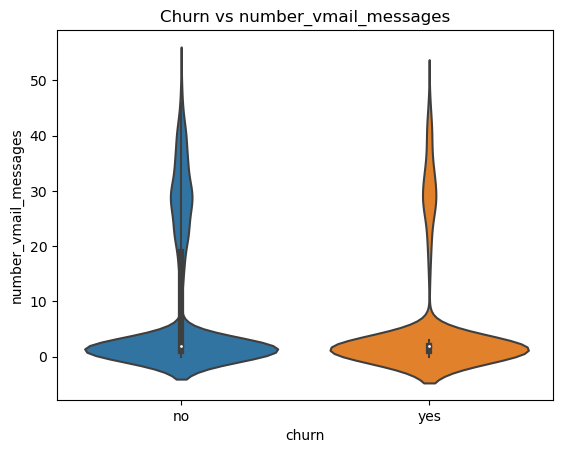

...

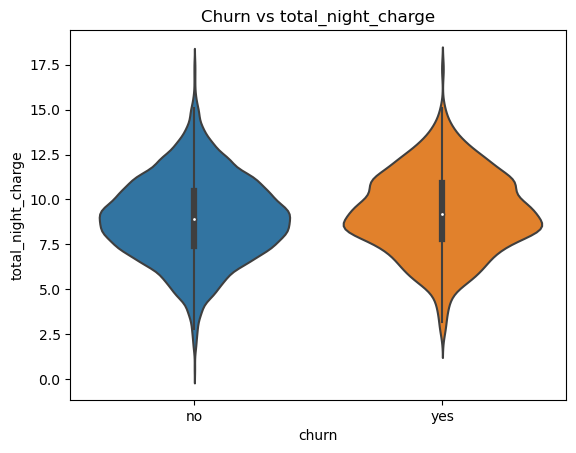

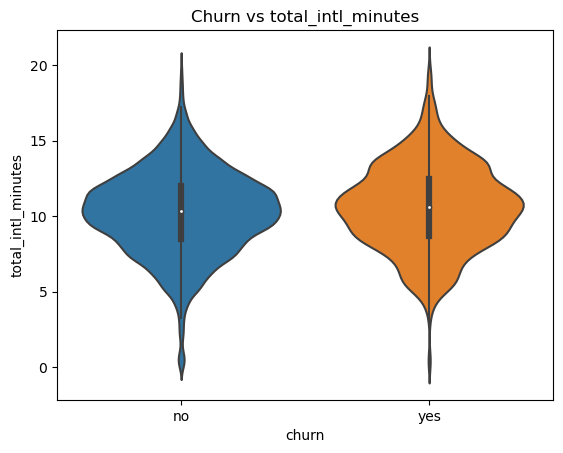

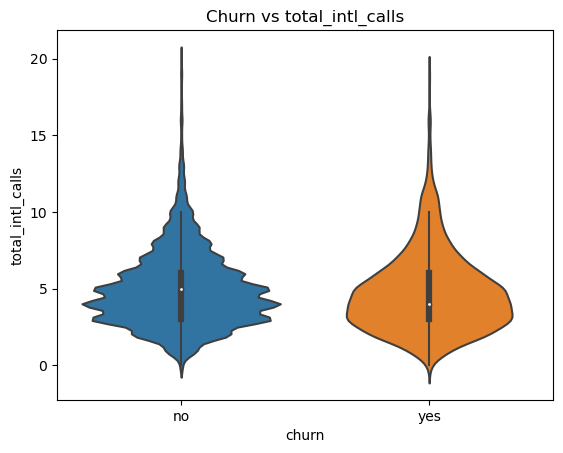

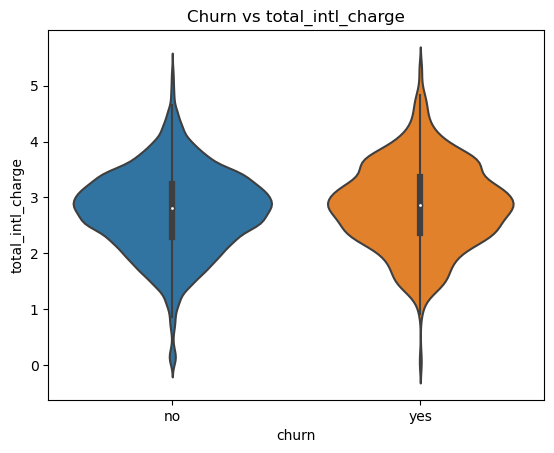

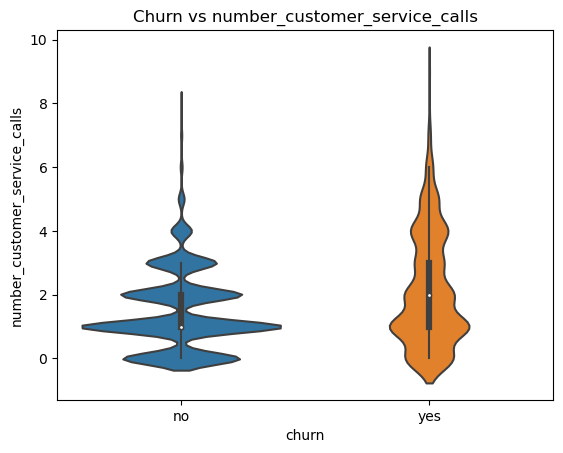

In [24]:
# plot out the distributions against churn
for col in train.select_dtypes(exclude='object').columns:
    sns.violinplot(x='churn', y=col, data=train).set_title(f'Churn vs {col}')
    plt.show()

Looking at the graph, customers who are likely to churn are those who have less remaining terms..

Reason can be many

Other great deal options

subscription costs

Not satisfy with the product

While looking at the graph, we want to look for drastic differences or weird shapes..

### What about Categorical Relationships to Churn

In [25]:
train.promotions_offered.unique()

array(['No', 'Yes', nan, 'NO'], dtype=object)

In [27]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [28]:
pivot_feature = 'promotions_offered'
pd.crosstab(train[pivot_feature], train['churn']) / len(train) # to get proportions

churn,no,yes
promotions_offered,,
No,0.821444,0.115847
Yes,0.032405,0.027476


82% of customers have not churn are not being offer a promotion

3% of customers have not churn are being offer a promotion

11% of customers have churn are not being offer a promotion

2% of customers have churn are being offer a promotion

Potential ideas to solve this.. Look into customers who gave bad rating + remaining term are short, maybe offer them promotions


### Is there a relationship between Remaining term and NPS Rating? And...promotions offered?
Namely when Remaining term < 5 and Last nps rating < 7

In [34]:
train['nps_less_7'] = (train['last_nps_rating'] < 7).astype(int)
train['remaining_term_less_5'] = (train['remaining_term'] < 5).astype(int)
train['churn_yes'] = train['churn'].apply(lambda x: 1 if x=='yes' else 0)
train['churn_no'] = train['churn'].apply(lambda x: 0 if x=='yes' else 1)

In [35]:
train.groupby(['nps_less_7', 'remaining_term_less_5']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.002610  0.414166
           1                       0.005437  0.084530
1          0                       0.041902  0.296143
           1                       0.093374  0.061838

In [36]:
# what if we add promotions in the table?
train.groupby(['nps_less_7', 'remaining_term_less_5', 'promotions_offered']).sum(['churn_yes', 'churn_no'])[['churn_yes', 'churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.002102  0.414166
                                 Yes                  0.000507  0.000000
           1                     No                   0.004277  0.084530
                                 Yes                  0.001160  0.000000
1          0                     No                   0.034290  0.296143
                                 Yes                  0.007612  0.000000
           1                     No                   0.075178  0.029433
                                 Yes                  0.018196  0.032405

8% of the customers are sitting at the churn when no promotions are being offered

In [43]:
# drop columns before preprocessing for modeling
train.drop(['nps_less_7', 'remaining_term_less_5', 'churn_yes', 'churn_no'], axis=1, inplace=True)

# 4. Data Preprocessing

## Double check we're operating with a clean slate

In [44]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [45]:
df.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [46]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

In [49]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  39
promotions_offered                0
remaining_term                   39
last_nps_rating                  39
area_code                        11
international_plan                0
voice_mail_plan                  29
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                17
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            39
dtype: int64

## Missing Area Code Data - Categorical

In [48]:
train[train['area_code'].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16450,FL,147,16.0,No,9.0,8.0,NaN,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
1045,FL,154,20.0,No,8.0,4.0,NaN,yes,no,0,...,123,12.660728,195.951478,137,8.485496,8.104295,4,2.375303,0,no


In [50]:
train['area_code'] = train['area_code'].fillna('missing')

## Missing Voice Mail Plan - Categorical

In [53]:
train['voice_mail_plan'] = train['voice_mail_plan'].fillna('missing')

## Missing Evening Minutes - Numeric

In [55]:
mean_eve_mins = train['total_eve_minutes'].mean().round(2)
mean_eve_mins

200.36

In [56]:
train['total_eve_minutes_missing'] = train['total_eve_minutes'].isnull().astype(int) # one-hot to 1 or 0
train['total_eve_minutes'] = train['total_eve_minutes'].fillna(mean_eve_mins)

In [57]:
train[train['total_eve_minutes_missing']==1]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,
1740,CO,77,18.0,No,2.0,1.0,area_code_408,no,no,1,...,14.616197,212.467694,62,9.456308,5.720870,6,1.449347,5,yes,1
16142,AZ,133,14.0,No,12.0,8.0,area_code_415,no,no,2,...,6.767451,189.817883,77,8.295507,9.916673,20,2.599281,0,no,1
11550,SC,110,23.0,No,10.0,7.0,area_code_415,no,no,2,...,11.162447,193.062311,109,8.401731,7.920757,6,1.921321,2,no,1
12703,CO,79,23.0,No,5.0,1.0,area_code_408,no,no,1,...,14.441229,209.347350,67,9.067451,5.459496,7,1.384230,5,yes,1
2729,SC,119,11.0,No,7.0,5.0,area_code_415,no,no,0,...,11.612971,182.751530,105,8.101761,7.526092,7,2.072387,2,no,1
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no,1
4908,CO,77,8.0,No,3.0,1.0,area_code_408,no,no,2,...,15.010492,214.613981,65,9.051352,5.226312,7,1.564927,5,yes,1
15977,WY,54,18.0,No,21.0,6.0,missing,no,missing,39,...,16.495990,181.509600,115,8.743469,9.708515,4,2.656175,0,no,1
2642,VA,126,10.0,No,12.0,9.0,area_code_510,no,no,2,...,21.361439,247.935719,116,11.547792,10.103504,3,2.765981,0,no,1


## Missing Target Variables

In [59]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  39
promotions_offered                0
remaining_term                   39
last_nps_rating                  39
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            39
total_eve_minutes_missing         0
dtype: int64

In [60]:
# 
train = train[~train['churn'].isnull()] # return back values where churn is not null
# train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

# 5. Feature Engineering

## Ratio for Correlated Predictor Variables

<AxesSubplot:>

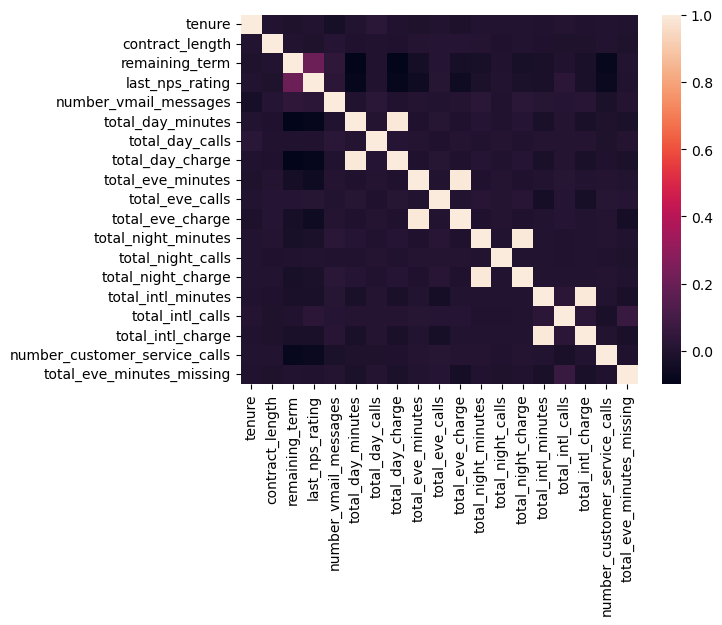

In [61]:
sns.heatmap(train.select_dtypes(exclude='object').corr())

Looking at the correlation map...

We notice total_day_charge and total_day_minutes.. and so forth are perfectly correlated..

For machine learning models, it is best to decorrelate features to make better predictions..

We will create new features for these namely ratios.

In [62]:
train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
train['night_ratio'] = train['total_night_charge'] / train['total_night_minutes']
train['intl_ratio'] = train['total_intl_charge'] / train['total_intl_minutes']

C:\Users\16178\AppData\Local\Temp\ipykernel_10844\275457803.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
C:\Users\16178\AppData\Local\Temp\ipykernel_10844\275457803.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
C:\Users\16178\AppData\Local\Temp\ipykernel_10844\275457803.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sl

In [64]:
train = train.drop(['total_day_charge', 'total_eve_charge', 'total_night_charge',
            'total_intl_charge', 'total_day_minutes', 'total_eve_minutes',
            'total_night_minutes', 'total_intl_minutes'], axis=1)

## Skewed Customer Service Calls

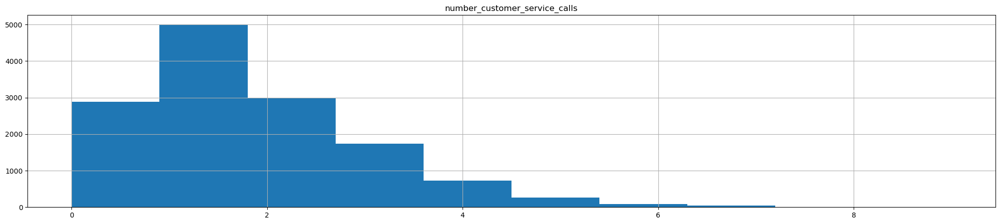

In [65]:
# check to see if customer services call are skew distribution..
train[['number_customer_service_calls']].hist(figsize=(25,5))
plt.show()

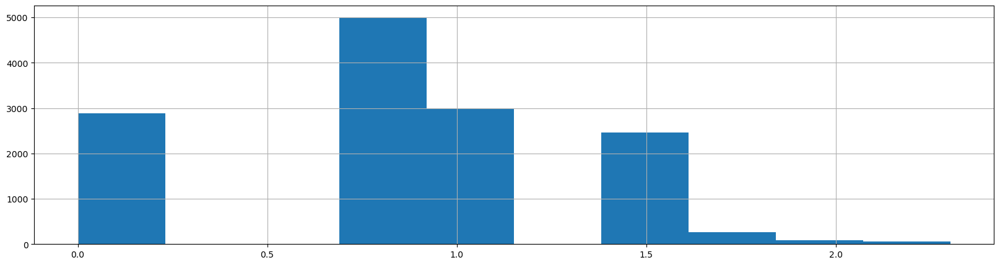

In [66]:
train['number_customer_service_calls'] = np.log(train['number_customer_service_calls'] + 1)
train['number_customer_service_calls'].hist(figsize=(20,5))
plt.show()

## Feature Engineering Unhappy Customers

Create new feature  to represent unhappy customers

In [67]:
# replace NO and any missing values to No
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [68]:
train['unhappy_customers'] = ((train.remaining_term < 5) & 
                              (train.last_nps_rating <= 7) &
                              (train.promotions_offered == 'No')).astype(int)

In [69]:
train['unhappy_customers']

id
4115     0
5910     0
8136     0
15227    0
16632    0
        ..
11284    1
11964    0
5390     1
860      0
15795    0
Name: unhappy_customers, Length: 13755, dtype: int32

## Create Target and Feature Variables

In [70]:
from sklearn.preprocessing import OneHotEncoder


In [71]:
x_train = train.drop('churn', axis=1)
y_train = np.where(train['churn'] == 'yes', 1, 0)

In [72]:
y_train # one-hot encoder

array([0, 0, 0, ..., 1, 0, 0])

In [73]:
# create one hot encoder
onehot = OneHotEncoder(handle_unknown='ignore')
# apply onehot encoding to catergorical columns
encoded_columns = onehot.fit_transform(x_train.select_dtypes(include='object')).toarray()

In [75]:
encoded_columns

array([[0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

In [77]:
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [78]:
x_train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers'],
      dtype='object')

In [79]:
# apply on numeric columns
x_train = x_train.select_dtypes(exclude='object')
x_train[onehot.get_feature_names_out()] = encoded_columns

In [80]:
x_train.columns

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

## Dealing with Imbalanced Classes

In [81]:
!pip install imblearn

In [82]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE, RandomOverSampler

In [83]:
# compute the smote class
sm = SMOTE(random_state=42)
# resample to balance the dataset
x_temp, y_temp = sm.fit_resample(x_train, y_train)

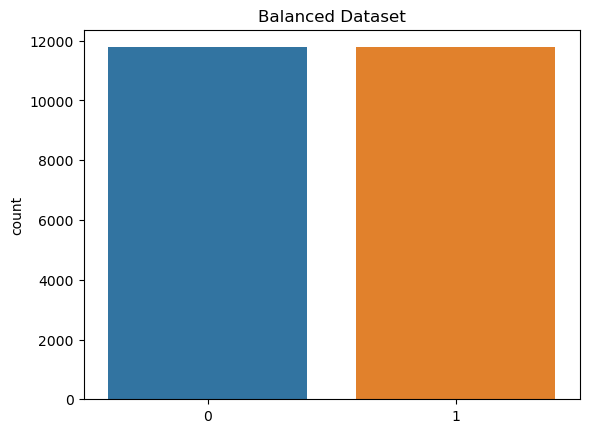

In [84]:
sns.countplot(x=y_temp).set_title('Balanced Dataset')
plt.show()

# 6. Modelling

## Build Pipelines

In [88]:
pip install xgboost


                                              0.0/70.9 MB ? eta -:--:--
                                              0.3/70.9 MB 6.5 MB/s eta 0:00:11
                                              0.7/70.9 MB 7.1 MB/s eta 0:00:10
                                              1.0/70.9 MB 7.1 MB/s eta 0:00:10
                                              1.3/70.9 MB 7.0 MB/s eta 0:00:11
                                              1.4/70.9 MB 6.1 MB/s eta 0:00:12
                                              1.4/70.9 MB 6.1 MB/s eta 0:00:12
                                              1.5/70.9 MB 4.9 MB/s eta 0:00:15
                                              1.8/70.9 MB 4.8 MB/s eta 0:00:15
     -                                        1.9/70.9 MB 4.4 MB/s eta 0:00:16
     -                                        2.0/70.9 MB 4.3 MB/s eta 0:00:17
     -                                        2.1/70.9 MB 4.4 MB/s eta 0:00:16
     -                                        2.2/70.9 MB 

In [85]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [89]:
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [90]:
pipelines = {
    'sgd': make_pipeline(StandardScaler(), SGDClassifier()),
    'ridge': make_pipeline(StandardScaler(), RidgeClassifier()),
    'rf': make_pipeline(StandardScaler(), RandomForestClassifier()),
    'gb': make_pipeline(StandardScaler(), GradientBoostingClassifier()),
    'xg': make_pipeline(StandardScaler(), XGBClassifier()),
}

## Build Grids

In [92]:
# seeing what hyperparameters we can tune
pipelines['gb'].get_params()

{'memory': None,
 'steps': [('standardscaler', StandardScaler()),
  ('gradientboostingclassifier', GradientBoostingClassifier())],
 'verbose': False,
 'standardscaler': StandardScaler(),
 'gradientboostingclassifier': GradientBoostingClassifier(),
 'standardscaler__copy': True,
 'standardscaler__with_mean': True,
 'standardscaler__with_std': True,
 'gradientboostingclassifier__ccp_alpha': 0.0,
 'gradientboostingclassifier__criterion': 'friedman_mse',
 'gradientboostingclassifier__init': None,
 'gradientboostingclassifier__learning_rate': 0.1,
 'gradientboostingclassifier__loss': 'log_loss',
 'gradientboostingclassifier__max_depth': 3,
 'gradientboostingclassifier__max_features': None,
 'gradientboostingclassifier__max_leaf_nodes': None,
 'gradientboostingclassifier__min_impurity_decrease': 0.0,
 'gradientboostingclassifier__min_samples_leaf': 1,
 'gradientboostingclassifier__min_samples_split': 2,
 'gradientboostingclassifier__min_weight_fraction_leaf': 0.0,
 'gradientboostingclassifie

In [93]:
grid = {
    'sgd': {
        'sgdclassifier__alpha':[0.0001, 0.001, 0.1]
    },
    'ridge': {
        'ridgeclassifier__alpha':[0.01, 0.05, 1.0, 2.0, 3.0]
    },
    'rf':{
        'randomforestclassifier__n_estimators':[50,100, 200,300],
        'randomforestclassifier__max_depth':[None, 5,7,9]
    },
    'gb': {
        'gradientboostingclassifier__n_estimators':[50,100,200],
        'gradientboostingclassifier__max_depth':[None, 3,5,7]
    },
    'xg': {
        'xgbclassifier__n_estimators':[50,100,200],
        'xgbclassifier__max_depth':[None, 3, 5, 7]
    }
}

## Train Models

In [94]:
from sklearn.model_selection import GridSearchCV

In [95]:
fit_models = {}
for algo, pipeline in pipelines.items():
    try:
        print(algo)
        # DO training here
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10) # split dataset into 10 individual folds and fine-tune and confirm performance on each set 
        model.fit(x_train, y_train)
        fit_models[algo] = model
        print(f'Training completed for {algo}')

    except Exception as e:
        print(f'There was an error training the {algo} model, {e}')

sgd
Training completed for sgd
ridge
Training completed for ridge
rf
Training completed for rf
gb
Training completed for gb
xg
Training completed for xg


# 7. Evaluation

## Apply Transformations to Test Data

In [96]:
col_order = x_train.columns; col_order

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

In [147]:
def transform_data(test_df, col_order, mean_eve_mins, onehot):
    
    x = test_df.copy()

    # re doing everything done on train set but on test set
    x['area_code'] = x['area_code'].fillna('missing')
    x['voice_mail_plan'] = x['voice_mail_plan'].fillna('missing')
    x['total_eve_minutes_missing'] = x['total_eve_minutes'].isnull().astype(int)
    x['total_eve_minutes'] = x['total_eve_minutes'].fillna(mean_eve_mins)

    # FE - Ratios
    x['day_ratio'] = x['total_day_charge'] / x['total_day_minutes']
    x['eve_ratio'] = x['total_eve_charge'] / x['total_eve_minutes']
    x['night_ratio'] = x['total_night_charge'] / x['total_night_minutes']
    x['intl_ratio'] = x['total_intl_charge'] / x['total_intl_minutes']
    x = x.drop(['total_day_charge', 'total_eve_charge', 'total_night_charge',
            'total_intl_charge', 'total_day_minutes', 'total_eve_minutes',
            'total_night_minutes', 'total_intl_minutes'], axis=1)

    # FE - Log transform
    x['number_customer_service_calls'] = np.log(x['number_customer_service_calls'] + 1)

    # FE - Unhappy customers
    x['promotions_offered'] = x['promotions_offered'].replace(['NO', np.NaN], 'No')
    x['unhappy_customers'] = ((x.remaining_term < 5) & 
                              (x.last_nps_rating <= 7) &
                              (x.promotions_offered == 'No')).astype(int)
    
    # Onehot encoder
    encoded_columns = onehot.transform(x.select_dtypes(include='object')).toarray()
    x = x.select_dtypes(exclude='object')
    x[onehot.get_feature_names_out()] = encoded_columns

    return x[col_order]

In [98]:
test = test[~test['churn'].isnull()]

In [148]:
x_test = transform_data(test.drop('churn', axis=1), col_order, mean_eve_mins, onehot)

In [101]:
y_test = np.where(test['churn'] == 'yes', 1,0)

## Evaluate Performance Metrics

In [102]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix

In [103]:
for algo, model in fit_models.items():
    yhat = model.predict(x_test)
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat)
    print(f"{algo} model scores Accuracy:{accuracy}, Precision:{precision}, Recall:{recall}")

sgd model scores Accuracy:0.918918918918919, Precision:0.7217573221757322, Recall:0.7026476578411406
ridge model scores Accuracy:0.9102005231037489, Precision:0.6895833333333333, Recall:0.6741344195519349
rf model scores Accuracy:0.953211275791921, Precision:0.8683035714285714, Recall:0.7922606924643585
gb model scores Accuracy:0.9540831153734379, Precision:0.8350100603621731, Recall:0.845213849287169
xg model scores Accuracy:0.9535018889857599, Precision:0.8370672097759674, Recall:0.8370672097759674


## Understanding Performance Metrics

In [110]:
# best model either XGBoost or GradientBoost
model = fit_models['xg']
yhat = model.predict(x_test)
confusion_matrix(y_test, yhat, labels=[1, 0])

array([[ 411,   80],
       [  80, 2870]], dtype=int64)

In [111]:
# best model either XGBoost or GradientBoost
model = fit_models['gb']
yhat = model.predict(x_test)
confusion_matrix(y_test, yhat, labels=[1, 0])

array([[ 415,   76],
       [  82, 2868]], dtype=int64)

## Make a Prediction

In [112]:
yhat = model.predict(x_test); yhat

array([0, 0, 0, ..., 0, 0, 0])

sometimes, you do this process called error analysis. Comparing true and prediction side by side and see what features are causing wrong predictions..

Another way is to do model explainability such as SHAP.

In [114]:
result = pd.DataFrame([y_test, yhat])
result = result.T
result.columns = ['ytrue', 'ypred']
result.head(20)

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
5,0,0
6,1,1
7,0,0
8,0,0
9,0,0


# 8. Deployment

## Save Models and Encoder

In [115]:
import os
import pickle

In [116]:
SAVE_PATH = os.path.join('models', 'experiment_1')
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [117]:
for algo, models in fit_models.items():
    FILE_PATH = os.path.join(SAVE_PATH, f'{algo}.pkl')
    with open(FILE_PATH, 'wb') as f:
        pickle.dump(model, f)

In [118]:
# Save one hot encoder
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, 'encoder.pkl')
with open(ENCODER_FILE_PATH, 'wb') as f:
    pickle.dump(onehot, f)

## Create a Model Schema

This is where we create JSON files to create model schema and prepare for deployment

In [152]:
def extract_column_values(col, df):
    """Prepare a slide-bar for users to select a range of value for features"""
    if df[col].dtype =='O':
        return list(df[col].unique())
    elif df[col].dtype =='int64':
        return (int(df[col].min()), int(df[col].max()) )
    elif df[col].dtype == 'float64':
        return (float(df[col].min()), float(df[col].max()))
    else:
        return list(df[col].unique().astype(str))

In [153]:
column_info = {col:{'dtype':str(df[col].dtype), 'values':extract_column_values(col, df)} for col in df.columns}

In [154]:
# extracted all of our transformed columns
transformed_cols = {'transformed_columns': x_train.columns.to_list()}
schema = {'column_info':column_info, 'transformed_columns': transformed_cols}

In [155]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [156]:
os.makedirs('app')

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'app'

In [157]:
import json
with open(os.path.join('app', 'schema.json'), 'w') as f:
    json.dump(schema, f)

this does not work, since we need to re-edit the json file.. Get rid of NaN and unnecessary inputs

## Test Scoring

In [158]:
# Load ML Model
with open(os.path.join(SAVE_PATH, 'xg.pkl'), 'rb') as f:
    model = pickle.load(f)

In [159]:
# Load Encoder
with open(os.path.join(SAVE_PATH, 'encoder.pkl'), 'rb') as f:
    onehot = pickle.load(f)

In [160]:
# Load schema
with open(os.path.join('app', 'schema.json'), 'r') as f:
    schema = json.load(f)

In [161]:
sample = {
  "state_code": "OH",
  "area_code": "area_code_415",
  "international_plan": "no",
  "voice_mail_plan": "yes",
  "number_vmail_messages": "26",
  "total_day_minutes": 161.6,
  "total_day_calls": 123,
  "total_day_charge": 27.47,
  "total_eve_minutes": 195.5,
  "total_eve_calls": 103,
  "total_eve_charge": 16.62,
  "total_night_minutes": 254.4,
  "total_night_calls": 103,
  "total_night_charge": 11.45,
  "total_intl_minutes": 13.7,
  "total_intl_calls": 3,
  "total_intl_charge": 3.7,
  "promotions_offered":"No", 
  "number_customer_service_calls": 5.0, 
  "tenure":4, 
  "contract_length":5,
  "remaining_term":10, 
  "last_nps_rating":10
}

In [162]:
schema['transformed_columns']['transformed_columns']

['tenure',
 'contract_length',
 'remaining_term',
 'last_nps_rating',
 'number_vmail_messages',
 'total_day_calls',
 'total_eve_calls',
 'total_night_calls',
 'total_intl_calls',
 'number_customer_service_calls',
 'total_eve_minutes_missing',
 'day_ratio',
 'eve_ratio',
 'night_ratio',
 'intl_ratio',
 'unhappy_customers',
 'state_code_AK',
 'state_code_AL',
 'state_code_AR',
 'state_code_AZ',
 'state_code_CA',
 'state_code_CO',
 'state_code_CT',
 'state_code_DC',
 'state_code_DE',
 'state_code_FL',
 'state_code_GA',
 'state_code_HI',
 'state_code_IA',
 'state_code_ID',
 'state_code_IL',
 'state_code_IN',
 'state_code_KS',
 'state_code_KY',
 'state_code_LA',
 'state_code_MA',
 'state_code_MD',
 'state_code_ME',
 'state_code_MI',
 'state_code_MN',
 'state_code_MO',
 'state_code_MS',
 'state_code_MT',
 'state_code_NC',
 'state_code_ND',
 'state_code_NE',
 'state_code_NH',
 'state_code_NJ',
 'state_code_NM',
 'state_code_NV',
 'state_code_NY',
 'state_code_OH',
 'state_code_OK',
 'state_co

In [163]:
# Extract column orders
column_order_in = list(schema['column_info'].keys())[:-1]
column_order_out = list(schema['transformed_columns']['transformed_columns'])

In [164]:
# Convert single prediction to a DF
scoring_data = pd.Series(sample).to_frame().T
scoring_data = scoring_data[column_order_in]

In [165]:
# Check datatypes
for column, column_properties in schema['column_info'].items(): 
    if column != 'churn': 
        dtype = column_properties['dtype']
        scoring_data[column] = scoring_data[column].astype(dtype)

In [166]:
column_order_out

['tenure',
 'contract_length',
 'remaining_term',
 'last_nps_rating',
 'number_vmail_messages',
 'total_day_calls',
 'total_eve_calls',
 'total_night_calls',
 'total_intl_calls',
 'number_customer_service_calls',
 'total_eve_minutes_missing',
 'day_ratio',
 'eve_ratio',
 'night_ratio',
 'intl_ratio',
 'unhappy_customers',
 'state_code_AK',
 'state_code_AL',
 'state_code_AR',
 'state_code_AZ',
 'state_code_CA',
 'state_code_CO',
 'state_code_CT',
 'state_code_DC',
 'state_code_DE',
 'state_code_FL',
 'state_code_GA',
 'state_code_HI',
 'state_code_IA',
 'state_code_ID',
 'state_code_IL',
 'state_code_IN',
 'state_code_KS',
 'state_code_KY',
 'state_code_LA',
 'state_code_MA',
 'state_code_MD',
 'state_code_ME',
 'state_code_MI',
 'state_code_MN',
 'state_code_MO',
 'state_code_MS',
 'state_code_MT',
 'state_code_NC',
 'state_code_ND',
 'state_code_NE',
 'state_code_NH',
 'state_code_NJ',
 'state_code_NM',
 'state_code_NV',
 'state_code_NY',
 'state_code_OH',
 'state_code_OK',
 'state_co

In [167]:
scoring_sample = transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [168]:
model.predict(scoring_sample)

array([0])

## Summary

This is essential project to almost all businesses since it is expensive to attract new customers versus retain a old one.